<a href="https://colab.research.google.com/github/elephantscale/E2E-Object-Detection-in-TFLite/blob/master/colab_training/Tutorial_Object_Detection_with_TFLite_salad.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tutorial: Object Detection with TFLite

## Introduction

Imagine that you have a niece or a nephew and you want to give them a present.
When you were growing up, your aunt gave you a "Find the Duck" book. You had lots of fun
finding the duck on every page of this board book. Today, you want to make this book
into a computer game. For that, you need to be able to teach the computer how to find
the duck. This is what this tutorial will teach you. (Your dataset
will have Japanese salads, so instead of a duck you will be looking for
a shrimp. Times change.)

<img src="https://github.com/elephantscale/E2E-Object-Detection-in-TFLite/blob/master/colab_training/find-the-duck-cartoon.png?raw=1"  alt="Find the duckie" width="512" height="512">

## Our plan

The task that you are about to undertake is called "Object Detection." The good news is that the
Google library called TensorFlow already does most of the groundwork for object detection.
Furthermore, the TensorFlow Lite part of this library will help you to put your app on a
phone or a device. The end result of your object detection will look like a screenshot below,
where you will be able to detect, out of a known set of objects, which ones are present
in our picture and what their locations are. This is called "annotations."

<img src="https://github.com/elephantscale/E2E-Object-Detection-in-TFLite/blob/master/colab_training/object-detection-cartoon.png?raw=1"  alt="Find the salad" width="512" height="512">

We will do it in three steps. 

1. You will have to prepare the data: those objects that you will be looking to identify. 
2. After you got the objects, you will have to convert them to the TFRecord format that Object Detection API expects.You will train the model with this data.
3. You will export the model to TFLite, preparing it to be used in your phone app.

In the next tutorial,
we will teach you how to use the resulting TFLite model in your phone app. So, let us start.

In [1]:
# Feel free to add anything more here that might generate random numbers\
import tensorflow as tf
import random
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import cv2
import os
random.seed(0)
np.random.seed(0)
tf.random.set_seed(0)

## Download Data

We will be using the salad dataset.  This dataset has 225 unique images with a total of 1757 unique objects identified within those images. Clearly,
most images have more than one object identified.

Each identified object is called an annotation.  It consists of a box drawn around the object (specified by coordinates), with a label that
indicates what the object is.

We will be downloading the .csv file that has the dataset, and then we will be downloading each of the images in that CSV file and storing them
into a folder.



In [2]:
!mkdir train_data
!gsutil -q  cp  gs://cloud-ml-data/img/openimage/csv/salads_ml_use.csv ./train_data/ && echo "CSV Downloaded."
!gsutil  -q -m cp  -r gs://cloud-ml-data/img/openimage/* ./train_data/ && echo "Images copied."
!mkdir -p /content/train_zip/train
!mkdir -p /content/test_zip/test
!cp -r /content/train_data/* /content/train_zip/train
!cp -r /content/train_data/* /content/test_zip/test


CSV Downloaded.
Images copied.


## Data Cleaning


We need to do a little massaging of the .csv file while we load it into a pandas dataframe.  There are some extraneous columns which we'v called e1,e2,e3,e4 that we are going to drop.  We will also use a regex to adjust the paths to the local path directory structure we made.

### Extract the number of images that should be recognized.

There a total of 5 labels of the objects in these images:

1. Baked Goods
2. Tomato
3. Cheese
4. Salad
5. Seafood

As you can see it is not entirely balanced, although the imbalance is not too severe.  Unbalanced datasets tend to perform more poorly on the minority classes, such as "Baked Goods" in this case.




In [3]:
import re
import pandas as pd

data = pd.read_csv('./train_data/csv/salads_ml_use.csv', header=None, names=['dataset', 'filename', 'class', 'xmin', 'ymin', 'e1', 'e2', 'xmax', 'ymax', 'e3', 'e4'])

data.filename = data.filename.apply(lambda x : re.sub(r'gs:\/\/cloud\-ml\-data\/img\/openimage\/', r'', x))
data.pop('e1')
data.pop('e2')
data.pop('e3')
data.pop('e4')

data.head()

,dataset,filename,class,xmin,ymin,xmax,ymax
0,TEST,103/279324025_3e74a32a84_o.jpg,Baked Goods,0.005743,0.084985,0.567511,0.735736
1,TEST,103/279324025_3e74a32a84_o.jpg,Salad,0.402759,0.310473,1.000000,0.982695
2,TEST,1064/3167707458_7b2eebed9e_o.jpg,Cheese,0.000000,0.000000,0.054865,0.480665
3,TEST,1064/3167707458_7b2eebed9e_o.jpg,Cheese,0.041131,0.401678,0.318230,0.785916
4,TEST,1064/3167707458_7b2eebed9e_o.jpg,Cheese,0.116263,0.065161,0.451528,0.286489


### Visualize the Data

Here is the data as we have it from the original dataset, which is in the AutoML CSV format.  That dataset has the following fields:
  * dataset: (i.e., TEST vs TRAINING vs VALIDATION)
  * filename: the path to the filename, originally `gs://` links but already downloaded by us.
  * class: a text string defining the class
  * xmin: a normalized (0.0-1.0) X (width) variable stating the lower left of the bounding box of the annotation.
  * ymin: a normalized (0.0-1.0) Y (height) variable stating the lower left of the bounding box of the annotation.
  * xmax: a normalized (0.0-1.0) X (width) variable stating the upper left of the bounding box of the annotation.
  * ymax: a normalized (0.0-1.0) Y (height) variable stating the upper left of the bounding box of the annotation.

In [4]:
from PIL import Image
import os

def get_width_height(s):

    root = "/content/train_zip/train"
    s['width'], s['height'] = Image.open(os.path.join(root, s["filename"])).size
    s['xmin'] = int(s['xmin'] * s['width'])
    s['ymin'] = int(s['ymin'] * s['height'])
    s['xmax'] = int(s['xmax'] * s['width'])
    s['ymax'] = int(s['ymax'] * s['height'])
    return(s)


data = data.apply(get_width_height, axis=1)
data = data[['dataset', 'filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']]
data.head()

,dataset,filename,width,height,class,xmin,ymin,xmax,ymax
0,TEST,103/279324025_3e74a32a84_o.jpg,1600,1200,Baked Goods,9,101,908,882
1,TEST,103/279324025_3e74a32a84_o.jpg,1600,1200,Salad,644,372,1600,1179
2,TEST,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,0,0,121,1041
3,TEST,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,90,870,702,1703
4,TEST,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,256,141,996,620


### Segment the data into training and test.

The dataset is already segmeneted into training and test, so we will follow those suggestions. We could also use scikit-learn to create our own partition of training and test, but we are not going to do that here.

We will then write the CSV files out using Pandas.

In [5]:
train_df = data[data['dataset'] == "TRAIN"]
train_df.pop("dataset")
test_df = data[data['dataset'] == "TEST"]
test_df.pop("dataset")

train_df.to_csv("train_data/train.csv", index=False, header=True)
test_df.to_csv("train_data/test.csv", index=False, header=True)

train_df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
410,3/2851/9211707942_609c7209f8_o.jpg,612,612,Salad,0,0,612,612
411,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,3,146,104,252
412,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,18,484,463,611
413,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,58,349,317,485
414,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,109,172,266,353


In [6]:
!cp /content/train_data/train.csv /content/train_zip/train_labels.csv
!cp /content/train_data/train.csv /content/test_zip/test_labels.csv


## Generate intermediate files

To be able to generate TFRecords from our salads dataset we first generate a `.csv` file that would contain the following fields - 
- filename
- width
- height
- class
- xmin
- ymin
- xmax
- ymax

Note that we have all these things already except for width and height. Our tfrecords script actually expects xmin/xmax and ymin/ymax to be unnormalized, so we will unnormalize them by converting them back to pixels.

The results are as follows:

In [7]:
!head -5 /content/train_data/train.csv

filename,width,height,class,xmin,ymin,xmax,ymax
3/2851/9211707942_609c7209f8_o.jpg,612,612,Salad,0,0,612,612
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,3,146,104,252
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,18,484,463,611
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,58,349,317,485


In [8]:
!head -5 /content/train_data/test.csv
#filename,width,height,class,xmin,ymin,xmax,ymax


filename,width,height,class,xmin,ymin,xmax,ymax
103/279324025_3e74a32a84_o.jpg,1600,1200,Baked Goods,9,101,908,882
103/279324025_3e74a32a84_o.jpg,1600,1200,Salad,644,372,1600,1179
1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,0,0,121,1041
1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,90,870,702,1703


In [9]:
train_df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
410,3/2851/9211707942_609c7209f8_o.jpg,612,612,Salad,0,0,612,612
411,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,3,146,104,252
412,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,18,484,463,611
413,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,58,349,317,485
414,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,109,172,266,353


In [10]:
test_df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,103/279324025_3e74a32a84_o.jpg,1600,1200,Baked Goods,9,101,908,882
1,103/279324025_3e74a32a84_o.jpg,1600,1200,Salad,644,372,1600,1179
2,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,0,0,121,1041
3,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,90,870,702,1703
4,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,256,141,996,620


### Getting the Labels in a dictionary

The labels are dataset dependent. In this case we have 5 labels, as mentioned above.  Rather than hardcode them, we will iterate through the training dataset to find them, then build a dictionary and a reverse dictionary to aid in lookup of those.

In [11]:
# We will be using the LABEL_DICT and REVERSE_LABEL_DICT later. Note we are not hardcoding
LABEL_DICT = {}
REVERSE_LABEL_DICT = {}
for i, label in enumerate(train_df["class"].drop_duplicates().sort_values().values):
  REVERSE_LABEL_DICT[i+1] = label
  LABEL_DICT[label] = i+1

print(LABEL_DICT)
print(REVERSE_LABEL_DICT)


{'Baked Goods': 1, 'Cheese': 2, 'Salad': 3, 'Seafood': 4, 'Tomato': 5}
{1: 'Baked Goods', 2: 'Cheese', 3: 'Salad', 4: 'Seafood', 5: 'Tomato'}


### Examine Class Balance.

Class balance is often an issue.  Ideally we would have equal representations of all the classes (i.e., in this case, salad, tomato, etc).

As you can see, classes are not balanced ideally, but the inbalance is not severe. We will proceed as is, noting that as "Tomato" is the majority class our model will likely be better at spotting tomatoes than anything else.

Tomato         606
Cheese         377
Salad          184
Seafood        114
Baked Goods     66
Name: class, dtype: int64

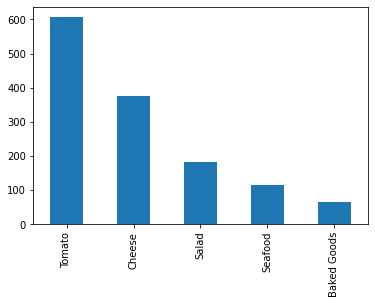

In [12]:
train_df["class"].value_counts().plot.bar()
train_df["class"].value_counts()

Tomato         96
Cheese         51
Salad          33
Seafood        22
Baked Goods    16
Name: class, dtype: int64

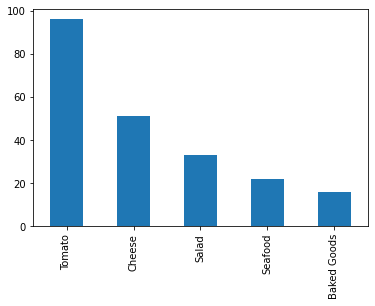

In [13]:
test_df["class"].value_counts().plot.bar()
test_df["class"].value_counts()

### See some sample images

I bet you are excited to see some of these delicious salads.  Let us write some matplotlib code that will take some random images of salads and display those. Note that we are *NOT* looking at the bounding boxes, only the images themselves.

In [14]:
def show_images(df, is_train=True):
    if is_train:
        root = "/content/train_zip/train"
    else:
        root = "/content/test_zip/test"
    plt.figure(figsize=(15,15))
    for i in range(10):
        n = np.random.choice(df.shape[0], 1)
        plt.subplot(5,5,i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(True)
        image = plt.imread(os.path.join(root, df.iloc[int(n),:]["filename"]))
        plt.imshow(image)
        label = df.iloc[int(n),:]["class"]
        plt.xlabel(label)
    plt.show()

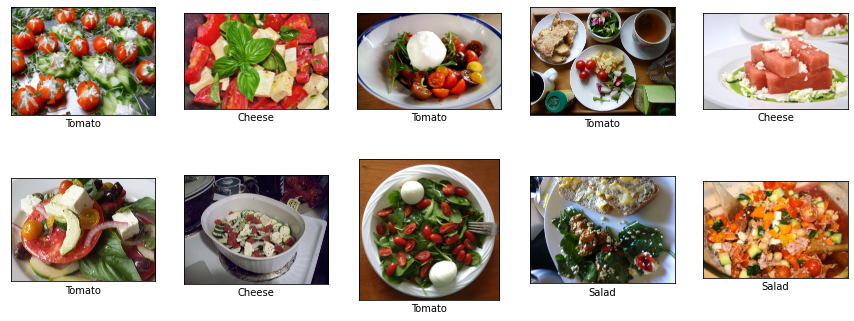

In [15]:
show_images(train_df)

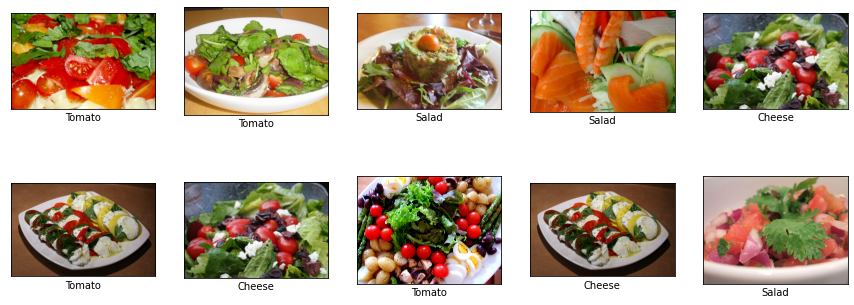

In [16]:
show_images(test_df, is_train=False)

### Examine Annotations

In Object Detection, we are looking for objects within an image.  Unlike classification, where the entire image is to be identified with a label, in object detection we are looking for objects *within* the image.

To specify this, we include annotations, usually more than one per image. An annotation is simply a box, specified with x,y coordinates, and label, usually a string of text identifying the object. Generally a human performs this for the training data, so we call this supervised learning.

Here we will use OpenCV to put a box on some of the images according to the annotations.  Please look for the small red box in each of the images.

In [17]:
def verify_annotations(df, is_train=True):
    if is_train:
        root = "/content/train_zip/train"
    else:
        root = "/content/test_zip/test"
    
    plt.figure(figsize=(12,12))
    for i in range(3):
        n = np.random.choice(df.shape[0], 1)
        plt.subplot(1,3,i+1)
        plt.xticks([])
        plt.yticks([])
        
        #image = plt.imread(os.path.join(root, df["filename"][int(n)]))
        image = plt.imread(os.path.join(root, df.iloc[int(n),:]["filename"]))

        xmin, ymin = int(df.iloc[int(n),:]["xmin"]), int(df.iloc[int(n),:]["ymin"])
        xmax, ymax = int(df.iloc[int(n),:]["xmax"]), int(df.iloc[int(n),:]["ymax"])
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (255,0,0), 3)
        plt.imshow(image)
    
    plt.show()

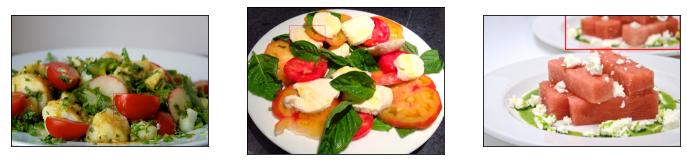

In [18]:
verify_annotations(train_df, is_train=True)

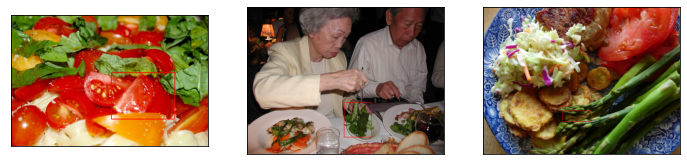

In [19]:
verify_annotations(test_df, is_train=False)

## Generate TFRecords and `.pbtxt`

We will be using the TFRecords format which is a binary-encoded sequence of records to be used in training and evaluation.

The TFRecord format is a simple format for storing a sequence of binary records.
The format is explained [here](https://www.tensorflow.org/tutorials/load_data/tfrecord)
but for our purposes it is enough that the code below created these records for us.

The utility scripts that I used in the following cells were adapted from [this repository](https://github.com/anirbankonar123/CorrosionDetector). 


### Get Models and Install API

Here we are going to get the tensorflow models directory and install the tensorflow Object detection API


In [20]:
%tensorflow_version 2.x
import tensorflow as tf 
print(tf.__version__)

!git clone -q https://github.com/tensorflow/models.git && echo " * Models Directory Cloned"

% cd models/research
!pip install --upgrade pip
# Compile protos.
!protoc object_detection/protos/*.proto --python_out=.
# Install TensorFlow Object Detection API.
!cp object_detection/packages/tf1/setup.py .
!python -m pip install  .

2.4.1
 * Models Directory Cloned
/content/models/research
     |████████████████████████████████| 1.5MB 16.3MB/s 
  Found existing installation: pip 19.3.1
    Uninstalling pip-19.3.1:
      Successfully uninstalled pip-19.3.1
Processing /content/models/research
     |████████████████████████████████| 352 kB 17.2 MB/s 
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1618434 sha256=d3fb778b0c5adccd52bfaa7166f57cabb3f6a90b76d3e151e58a1dcdd48ad046
  Stored in directory: /tmp/pip-ephem-wheel-cache-myduifna/wheels/16/63/fd/1293066bf448f757979af1b45c59b0e33b46f12d4454d12fde
Successfully built object-detection


### Download Generate Data Script

Here we are going to download the `generate_data.py` script which will convert the CSV files into the TFRecords format.

We will run on both training and test data, to get the output.


In [21]:

# download the TF Record script
!wget -q https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/generate_data.py

In [22]:
!python generate_data.py \
    --csv_input=/content/train_zip/train_labels.csv \
    --output_path=/content/train_zip/train.record

2021-02-10 02:57:47.153547: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Successfully created the TFRecords: /content/train_zip/train.record


In [23]:
!python generate_data.py \
    --csv_input=/content/test_zip/test_labels.csv \
    --output_path=/content/test_zip/test.record

2021-02-10 02:57:50.496478: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Successfully created the TFRecords: /content/test_zip/test.record


In [24]:
!pwd
!ls -lh /content/test_zip/*.record
!ls -lh /content/train_zip/*.record

/content/models/research
-rw-r--r-- 1 root root 257M Feb 10 02:57 /content/test_zip/test.record
-rw-r--r-- 1 root root 257M Feb 10 02:57 /content/train_zip/train.record


Be sure to store these `.record` files to somewhere safe. Next, we need to generate a `.pbtxt` file that defines a mapping between our classes and integers. In the `generate_tfrecord.py` script, we used the following mapping - 


In this notebook we will be fine-tuning a **MobileNet** model on the [**salads dataset**](https://storage.googleapis.com/openimages/web/index.html). We will examine the workflow to fine-tune, perform inference, and then export the model to tflite

# Fetch pre-trained Mobilenet model checkpoints and configuration

MobileNet comes in different variants (refer [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md)). We will be using the `ssd_mobilenet_v2_320x320_coco17_tpu-8` variant. 

TFOD API operates with configuration files to train and evaluate models (the TF 2 release supports eager model execution too). For the purpose of this notebook, I created a configuration file following instructions from [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/configuring_jobs.md). Note that I purposefully kept the `num_steps` argument to a small number.

-  `batch_size: 32` : to accomdate lower memory in colab.
- `num_classes`: to the number of classes in teh new datasets.
- `total_steps`: reduced significantly to speed training time
- `warmup_setps`: reduced significantly to speed training time.
- `label_map_path` updated to local file system `"/content/models/research/label_map.pbtxt"`
- `input_path` (train) updated to local file system `"/content/models/research/train.record"`
- `input_path` (eval) updated to lcoa file system `"/content/models/research/test.record"`
- `fine_tune_checkpont` pointing to the checkpoint from training for fine tuning.


- `label_map_path` and `input_path` inside `train_input_reader` and `tf_record_input_reader` respectively. The `num_examples` argument inside `eval_config` is set to 117.

### Download model checkpoint and config

In [25]:
!cd /content/models/research

!wget -q http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
!rm -rf *.config
!wget -q https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_4.config
!wget -q https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_5.config


### Untar and verify the file structure of the model checkpoints

In [26]:
!cd /content/models/research
!tar -xvf ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
!cp /content/test_zip/test.record /content/models/research
!cp /content/train_zip/train.record /content/models/research

ssd_mobilenet_v2_320x320_coco17_tpu-8/
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0.index
ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/saved_model.pb
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/variables.index


# Model training

### Start training

Time to train! Actually to fine-tune.  We already have trained weights on the COCO dataset, but we are going to use our salad dataset in order to perform transfer learning, teach it to extract labels from there.

We are going to call the python trainging module from the tensorflow object detection API  and run it: "model_main_tf2.py" to run. Note that this will likely take a long time, and currently runs best with a GPU instance.





In [27]:

import os
os.environ['PYTHONPATH'] += ":/content/models"

import sys
sys.path.append("/content/models")


In [28]:
!mv /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint0



In [47]:

PIPELINE_CONFIG_PATH="/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_5.config"


MODEL_DIR="/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8"

CHECKPOINT_DIR="/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint"


!echo $PIPELINE_CONFIG_PATH
!echo $MODEL_DIR

!python object_detection/model_main_tf2.py \
    --pipeline_config_path={PIPELINE_CONFIG_PATH} \
    --model_dir={MODEL_DIR} \
    --checkpoint_every_n=200 \
    --alsologtostderr

/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_5.config
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8
2021-02-10 03:17:43.375903: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-02-10 03:17:46.099957: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-02-10 03:17:46.100967: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-02-10 03:17:46.105554: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-10 03:17:46.106132: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 device

In [48]:
!ls -d /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/*


/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint0
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-1.data-00000-of-00001
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-1.index
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-2.data-00000-of-00001
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-2.index
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-3.data-00000-of-00001
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-3.index
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-4.data-00000-of-00001
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-4.index
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-5.data-00000-of-00001
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-5.index
/content/models/resea

In [49]:
!zip -r ssd_mobilenet_v2_320x320_coco17_tpu-8.zip ssd_mobilenet_v2_320x320_coco17_tpu-8/

updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/ (stored 0%)
updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-1.data-00000-of-00001 (deflated 7%)
updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-6.index (deflated 81%)
updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint (deflated 74%)
updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-5.data-00000-of-00001 (deflated 7%)
updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/train/ (stored 0%)
updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/train/events.out.tfevents.1612925900.2b5d2e4d57ac.659.2928.v2 (deflated 0%)
updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/ckpt-3.index (deflated 81%)
updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/ (stored 0%)
updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/ (stored 0%)
updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001 (deflated 7%)
updating: ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/vari

# Export TFLite compatible graph

To export the fine-tuned checkpoints to a TFLite model we first need to export a model graph that is compatible with TFLite. More instructions about this are available [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/running_on_mobile_tensorflowlite.md). First, we need to determine which checkpoints to be used to export the graph. Let's first take a look at our `MODEL_DIR` to get an idea. 

In [50]:
!ls -lh $MODEL_DIR

total 197M
-rw-r--r-- 1 root   root   609 Feb 10 03:16 checkpoint
drwxr-x--- 2 345018 89939 4.0K Jul 10  2020 checkpoint0
-rw-r--r-- 1 root   root   18M Feb 10 02:59 ckpt-1.data-00000-of-00001
-rw-r--r-- 1 root   root   22K Feb 10 02:59 ckpt-1.index
-rw-r--r-- 1 root   root   36M Feb 10 03:02 ckpt-2.data-00000-of-00001
-rw-r--r-- 1 root   root   41K Feb 10 03:02 ckpt-2.index
-rw-r--r-- 1 root   root   36M Feb 10 03:06 ckpt-3.data-00000-of-00001
-rw-r--r-- 1 root   root   41K Feb 10 03:06 ckpt-3.index
-rw-r--r-- 1 root   root   36M Feb 10 03:09 ckpt-4.data-00000-of-00001
-rw-r--r-- 1 root   root   41K Feb 10 03:09 ckpt-4.index
-rw-r--r-- 1 root   root   36M Feb 10 03:12 ckpt-5.data-00000-of-00001
-rw-r--r-- 1 root   root   41K Feb 10 03:12 ckpt-5.index
-rw-r--r-- 1 root   root   36M Feb 10 03:16 ckpt-6.data-00000-of-00001
-rw-r--r-- 1 root   root   41K Feb 10 03:16 ckpt-6.index
-rw-r----- 1 345018 89939 4.4K Jul 11  2020 pipeline.config
drwxr-x--- 4 345018 89939 4.0K Feb 10 03:17 saved_

In [51]:
ls -l $MODEL_DIR/saved_model

total 9112
drwxr-xr-x 2 root   root     4096 Feb 10 03:17 assets/
-rw-r--r-- 1 root   root  9320977 Feb 10 03:17 saved_model.pb
drwxr-x--- 2 345018 89939    4096 Feb 10 03:17 variables/


In [52]:
!find /content -name "*tflite*"

/content/models/research/lstm_object_detection/export_tflite_lstd_model.py
/content/models/research/lstm_object_detection/export_tflite_lstd_graph_lib.py
/content/models/research/lstm_object_detection/export_tflite_lstd_graph.py
/content/models/research/lstm_object_detection/tflite
/content/models/research/lstm_object_detection/tflite/mobile_ssd_tflite_client.h
/content/models/research/lstm_object_detection/tflite/mobile_lstd_tflite_client.h
/content/models/research/lstm_object_detection/tflite/mobile_ssd_tflite_client.cc
/content/models/research/lstm_object_detection/tflite/mobile_lstd_tflite_client.cc
/content/models/research/lstm_object_detection/test_tflite_model.py
/content/models/research/object_detection/export_tflite_graph_lib_tf2_test.py
/content/models/research/object_detection/export_tflite_ssd_graph_lib.py
/content/models/research/object_detection/export_tflite_ssd_graph_lib_tf1_test.py
/content/models/research/object_detection/export_tflite_graph_tf2.py
/content/models/res

The checkpoint files with the prefix `model.ckpt-2000` are the ones we would be going with. 

### Exportthe TFLite Graph

Now it's time to run the `export_tflite_graph_tf2.py` file from the object detection API.  It will take our graph and export it to tflite.

The output is as follows:

  * `detection_boxes`: a float32 tensor of shape `[1, num_boxes, 4]` with box locations
  * `detection_classes`: a float32 tensor of shape `[1, num_boxes]` with class indices. (i.e., 1, which we can then look up to get the text class label)
  * `detection_scores`: a float32 tensor of shape `[1, num_boxes]` with class scores. (These are normalized 0.0-1.0 metric of confidence).
  * `num_boxes`: a float32 tensor of size 1 containing the number of detected boxes

In [35]:
#Export TFLite compatible graph
#Always verify the paths before running this command. 

# OUTPUT:
  # detection_boxes: a float32 tensor of shape [1, num_boxes, 4] with box locations
  # detection_classes: a float32 tensor of shape [1, num_boxes] with class indices
  # detection_scores: a float32 tensor of shape [1, num_boxes] with class scores
  # num_boxes: a float32 tensor of size 1 containing the number of detected boxes

!python /content/models/research/object_detection/export_tflite_graph_tf2.py \
    --pipeline_config_path $PIPELINE_CONFIG_PATH \
    --trained_checkpoint_dir $MODEL_DIR \
    --output_directory $MODEL_DIR 


2021-02-10 03:16:35.468654: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-02-10 03:16:41.764008: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-02-10 03:16:41.777204: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-02-10 03:16:41.820328: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-10 03:16:41.820930: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.73GiB deviceMemoryBandwidth: 298.08GiB/s
2021-02-10 03:16:41.820972: I tensorflow/stream_executor/platform/default/dso_loade

### Verify the TFLite compatible graph size

 It should have the `.pb` extension. Be sure to note down the path you would get as the output of code block.

In [36]:
!ls -lh $MODEL_DIR/saved_model/*.pb

-rw-r--r-- 1 root root 8.9M Feb 10 03:17 /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/saved_model.pb


Now that we have the graph wcan convert it to TensorFlow Lite.

# See the model training information (such as loss curves) in TensorBoard (within Colab Notebook)

Tensorboard can help us visualize what happened, and will be useful for doing an analysis of training.

You may have to click on the "refresh" icon on the upper right of the tensorboard below, otherwise it may say "No dashboards are active for the current data set".



In [37]:

%tensorflow_version 2.x
%load_ext tensorboard
%tensorboard --logdir /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8

Output hidden; open in https://colab.research.google.com to view.

# Export to TFLite

### Quantize and serialize

For the purpose of this notebook, we will only be quantizing using the [dynamic-range quantization](https://www.tensorflow.org/lite/performance/post_training_quant). But you can follow [this notebook](https://colab.research.google.com/github/sayakpaul/Adventures-in-TensorFlow-Lite/blob/master/MobileDet_Conversion_TFLite.ipynb) if you are interested to try out the other ones like integer quantization and `float16` quantization. 

As the .pb file we generated in the earlier step is a frozen graph, we need to use `tf.compat.v1.lite.TFLiteConverter.from_frozen_graph` to convert it to TFLite.

The MobileNet checkpoints we used accept 320x320 images, hence the `input_shapes` argument is specified that way. I specified the other arguments following instructions from [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/running_on_mobile_tensorflowlite.md).


In [53]:
saved_model_dir = "/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model"

converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_dir)
converter.target_spec.supported_ops = [
  tf.lite.OpsSet.TFLITE_BUILTINS, # enable TensorFlow Lite ops.
  tf.lite.OpsSet.SELECT_TF_OPS # enable TensorFlow ops.
]
tflite_filename = "salads_detector" + "_dr" + ".tflite"
tflite_model = converter.convert()
open(tflite_filename, "wb").write(tflite_model)
print(f"TFLite model generated: {tflite_filename}")
!ls -lh $tflite_filename
!pwd
!cp $tflite_filename /content

TFLite model generated: salads_detector_dr.tflite
-rw-r--r-- 1 root root 18M Feb 10 03:19 salads_detector_dr.tflite
/content/models/research


# Run inference


We are going to now use our trained TFLite model to perform inference, that is, to identify objects from an new image that we have not yet identified.

In [54]:
#Imports
import matplotlib
import matplotlib.pyplot as plt

import cv2
import re
import time
import numpy as np

from PIL import Image

### TFLite Interpreter and detection utils 

Sourced from [here](https://github.com/tensorflow/examples/blob/master/lite/examples/object_detection/raspberry_pi/detect_picamera.py).

These detection utilities perform the following:

 * `set_input_tensor`: takes the image data and uses it to create the input tensor.
 * `get_output_tensor`: get the output tensor at the index.
 * `detect_objects`: takes the output tensor of the model and unpacks each component: boxes, classes, scores, and count, and puts it in a vanilla python dictionary.




In [55]:

def set_input_tensor(interpreter, image):
  """Sets the input tensor."""
  tensor_index = interpreter.get_input_details()[0]['index']
  input_tensor = interpreter.tensor(tensor_index)()[0]
  input_tensor[:, :] = image


def get_output_tensor(interpreter, index):
  """Returns the output tensor at the given index."""
  output_details = interpreter.get_output_details()[index]
  tensor = np.squeeze(interpreter.get_tensor(output_details['index']))
  return tensor


def detect_objects(interpreter, image, threshold):
  """Returns a list of detection results, each a dictionary of object info."""
  set_input_tensor(interpreter, image)
  interpreter.invoke()

  # Get all output details
  boxes = get_output_tensor(interpreter, 0)
  classes = get_output_tensor(interpreter, 1)
  scores = get_output_tensor(interpreter, 2)
  count = int(get_output_tensor(interpreter, 3))

  results = []
  for i in range(count):
    if scores[i] >= threshold:
      result = {
          'bounding_box': boxes[i],
          'class_id': classes[i],
          'score': scores[i]
      }

      print('result: ', result)

      results.append(result)
  return results


### Demonstrate image for validation

Here is the real test.  We are going to pull [an image](https://upload.wikimedia.org/wikipedia/commons/0/04/Salad.jpg) from the internet. Note it is wikimedia and creative commons licenseed.

Doesn't it look delicious?  But more importantly, do you think our model can identify objects from it?  If so, which objects do you guess our model will be best at identifying?

Let's just view the image.



In [56]:
# Supply a path to download a relevant image
IMAGE_PATH = "https://upload.wikimedia.org/wikipedia/commons/0/04/Salad.jpg" 

!wget -q -O image.png $IMAGE_PATH
!cp image.png /content
Image.open('image.png')

Output hidden; open in https://colab.research.google.com to view.

### Load the TFLite Model

The TFLite model is saved as a `.tflite` file.  We need to load that saved file into the tflite interpreter.  What we will do is specify the file, and then we will allocate the tensors. 

Note that the model has a particular image size (300 x 300) in this case that we need to set.  We can get this by simply looking at the `shape` of the input

In [57]:
# Load the TFLite model
interpreter = tf.lite.Interpreter(model_path="/content/salads_detector_dr.tflite")
interpreter.allocate_tensors()
_, HEIGHT, WIDTH, _ = interpreter.get_input_details()[0]['shape']
print(f"Height and width accepted by the model: {HEIGHT, WIDTH}")

Height and width accepted by the model: (300, 300)


### Preprocess the image

We need to get our image that we got from the internet sized preoperly.  We're going to use this to resize it (to 300 x 300) and create a tf.Tensor out of it.

In [58]:
# Image preprocessing utils
def preprocess_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.io.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    original_image = img
    resized_img = tf.image.resize(img, (HEIGHT, WIDTH))
    resized_img = resized_img[tf.newaxis, :]
    return resized_img, original_image

### Visualize the image with objects identified

We have some helper code that will take the image, plot it, and unpack the output forom tflite and plot the boxes on top of the image.

The boxes are the objects that the tflite model will detect from our image, not the annotations that we had done on the training data. This is because this is a new image that we have never seen before.




In [59]:
# Define the label dictionary and color map


COLORS = np.random.randint(0, 255, size=(len(LABEL_DICT), 3), 
                            dtype="uint8")

In [65]:

# Inference utils
def display_results(image_path, threshold=0.3):
    # Load the input image and preprocess it
    preprocessed_image, original_image = preprocess_image(image_path)

    # =============Perform inference=====================
    start_time = time.monotonic()
    results = detect_objects(interpreter, preprocessed_image, threshold=threshold)
    print(f"Elapsed time: {(time.monotonic() - start_time)*1000} miliseconds")

    print(results)
    # =============Display the results====================
    original_numpy = original_image.numpy()
    for obj in results:
        # Convert the bounding box figures from relative coordinates
        # to absolute coordinates based on the original resolution
        ymin, xmin, ymax, xmax = obj['bounding_box']
        xmin = int(xmin * original_numpy.shape[1])
        xmax = int(xmax * original_numpy.shape[1])
        ymin = int(ymin * original_numpy.shape[0])
        ymax = int(ymax * original_numpy.shape[0])

        # Grab the class index for the current iteration
        idx = int(obj['class_id'])
        # Skip the background
        if idx >= len(LABEL_DICT):
          #print(str(idx) + ' idx >= len(LABEL_DICT)')
          pass
          # continue

        # Draw the bounding box and label on the image
        #color = [int(c) for c in COLORS[idx]]
        color = [int(c) for c in COLORS[0]]
        cv2.rectangle(original_numpy, (xmin, ymin), (xmax, ymax), 
                    color, 2)
        y = ymin - 15 if ymin - 15 > 15 else ymin + 15
        reverse_label = REVERSE_LABEL_DICT[idx] if idx in REVERSE_LABEL_DICT else 'Other'
        if idx == 56:
          reverse_label = 'Tomato'
        label = "{}: {:.2f}%".format(reverse_label, obj['score'] * 100)
        #label= ""
        cv2.putText(original_numpy, label, (xmin, y),
            cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # return the final imaage
    original_int = (original_numpy * 255).astype(np.uint8)
    return original_int

### Examine Output of Inference

Inference output is from the `display_results` function above.  We are outputting a vanilla python dictionary with the following:
 * bounding_box: The 4 xmin,ymin,xmax,ymax of the box identified.
 * class_id: the integer corresponding to the class identified by the model.
 * score: a normalized (0.0-1.1) score indicating the confidence in the identification.


 We will also view the image with the identified objects.

result:  {'bounding_box': array([0.19119984, 0.26252824, 1.0073812 , 0.6360584 ], dtype=float32), 'class_id': 2.0, 'score': 0.016762406}
result:  {'bounding_box': array([0.32708588, 0.18903369, 1.0582119 , 1.0527096 ], dtype=float32), 'class_id': 1.0, 'score': 0.01570487}
result:  {'bounding_box': array([-26.640577  ,   0.8881786 ,  27.06093   ,   0.88978755],
      dtype=float32), 'class_id': 1.0, 'score': 0.014788955}
result:  {'bounding_box': array([0.01275623, 0.3082475 , 1.1073177 , 1.1589882 ], dtype=float32), 'class_id': 0.0, 'score': 0.014683962}
result:  {'bounding_box': array([-0.314819  ,  0.70063555,  0.7204393 ,  0.9023384 ], dtype=float32), 'class_id': 1.0, 'score': 0.012021303}
result:  {'bounding_box': array([ 0.1323933 , -0.8404399 ,  0.45848352,  1.3163272 ], dtype=float32), 'class_id': 0.0, 'score': 0.0116196275}
result:  {'bounding_box': array([0.06590816, 0.75117373, 0.83353126, 0.8819946 ], dtype=float32), 'class_id': 1.0, 'score': 0.011468351}
result:  {'bounding

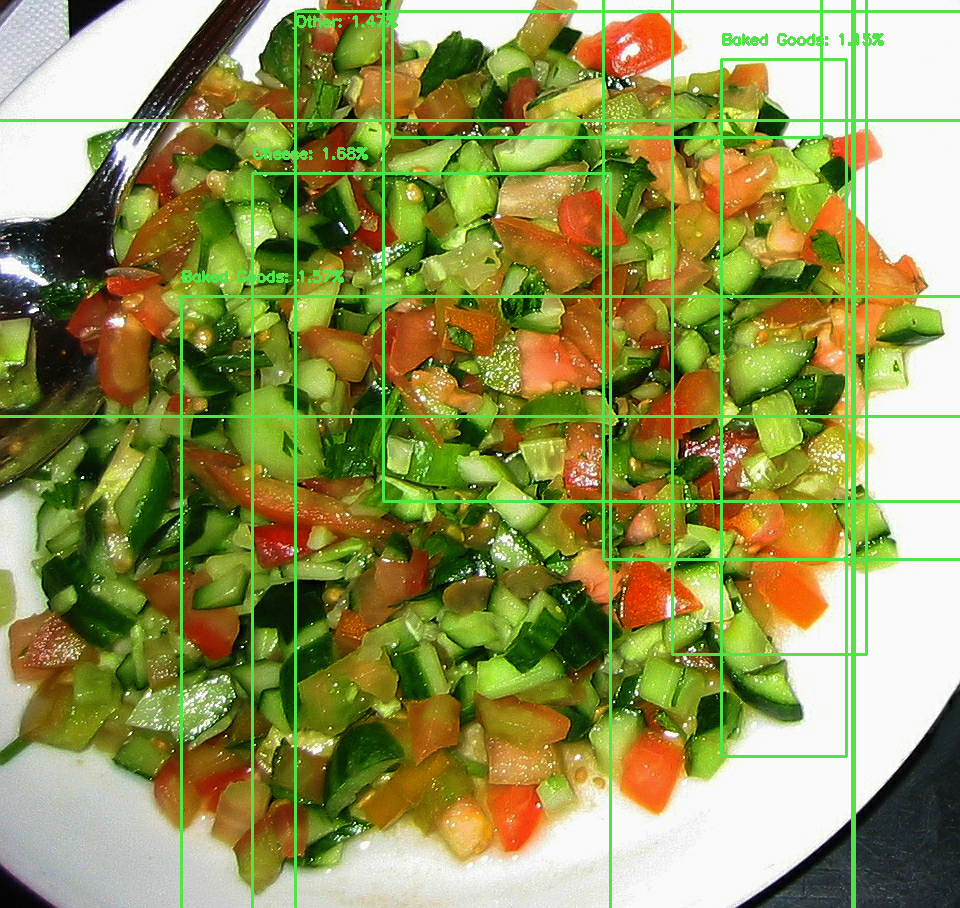

In [67]:
# Run inference and measure the inference time
resultant_image = display_results("/content/image.png", threshold=0.01)
Image.fromarray(resultant_image)


Notice that we correctly identified some objects in the example image (mostly tomatoes). As tomatoes were the majority of our training dataset, this is not surprising.  


**Congradulations!**

You've successfully exported the model to TFLite, and used it to identify objects in an image!

What now?

If we were going to go further with this, we would likely want to include a more balanced class set, and significantly increase training steps in order to make sure we are getting a truly accurate.

Also, we would want to save our model checkpoint away to ensure that we can continue to fine tune it.